In [1]:
using Pkg; Pkg.activate("/home/dhairyagandhi96/modelzoo/model-zoo/script/../vision/cppn"); Pkg.instantiate(); Pkg.add(PackageSpec(name="CUDAdrv", rev = "master")); Pkg.add(PackageSpec(name="CUDAnative", rev = "master")); Pkg.add(PackageSpec(name="CuArrays", rev = "master")); Pkg.add(PackageSpec(name="Flux", rev = "master"))

  Updating registry at `~/.julia/registries/General`
  Updating git-repo `https://github.com/JuliaRegistries/General.git`
  Building CUDAdrv → `~/.julia/packages/CUDAdrv/JWljj/deps/build.log`
  Updating git-repo `https://github.com/JuliaGPU/CUDAdrv.jl.git`
 Resolving package versions...
  Updating `~/modelzoo/model-zoo/vision/cppn/Project.toml`
 [no changes]
  Updating `~/modelzoo/model-zoo/vision/cppn/Manifest.toml`
 [no changes]
  Updating git-repo `https://github.com/JuliaGPU/CUDAnative.jl.git`
 Resolving package versions...
  Updating `~/modelzoo/model-zoo/vision/cppn/Project.toml`
 [no changes]
  Updating `~/modelzoo/model-zoo/vision/cppn/Manifest.toml`
 [no changes]
  Updating git-repo `https://github.com/JuliaGPU/CuArrays.jl.git`
 Resolving package versions...
  Updating `~/modelzoo/model-zoo/vision/cppn/Project.toml`
 [no changes]
  Updating `~/modelzoo/model-zoo/vision/cppn/Manifest.toml`
 [no changes]
  Updating git-repo `https://github.com/FluxML/Flux.jl.git`
 Resolving pack

Ref: http://blog.otoro.net/2016/03/25/generating-abstract-patterns-with-tensorflow/

In [2]:
using Images
using Flux

set parameters

In [3]:
z_dim = 2
x_dim = 512
y_dim = 512
N = 14
hidden = 9
batch_size = 1024
n = x_dim * y_dim

262144

cast 0:x-1 to -0.5:0.5

In [4]:
cast(x) = [range(-0.5, stop=0.5, step=1/(x - 1))...]

xs, ys = cast(x_dim), cast(y_dim)
xs = repeat(xs, inner=(y_dim))
ys = repeat(ys, outer=(x_dim))
rs = sqrt.(xs.^2 + ys.^2)

262144-element Array{Float64,1}:
 0.7071067811865476
 0.7057243672141199
 0.7043446771602189
 0.702967727063262 
 0.7015935330555991
 0.7002221113638016
 0.6988534783089481
 0.6974876503069023
 0.6961246438685855
 0.6947644756002421
 ⋮                 
 0.6961246438685855
 0.6974876503069023
 0.6988534783089481
 0.7002221113638016
 0.7015935330555991
 0.702967727063262 
 0.7043446771602189
 0.7057243672141199
 0.7071067811865476

sample weigths from a gaussian distribution

In [5]:
unit(in=N, out=N, f=tanh) = Dense(in, out, f, initW=randn)

unit (generic function with 4 methods)

input -> [x, y, r, z...]

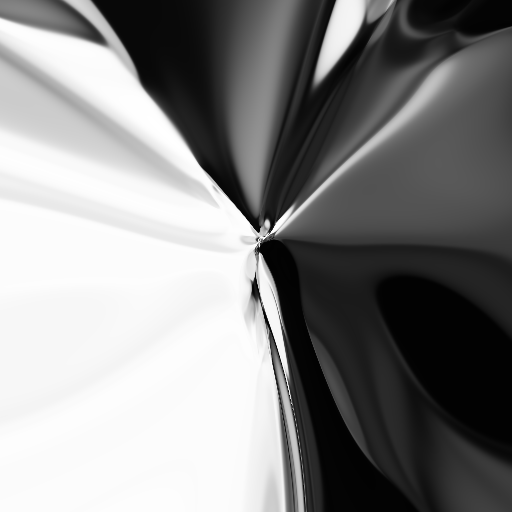

In [6]:
layers = Any[unit(3 + z_dim)]
for i=1:hidden
    push!(layers, unit())
end
push!(layers, unit(N, 1, σ))

model = Chain(layers...)
getColorAt(x) = Flux.data(model(x))

function batch(arr, s)
    batches = []
    l = size(arr, 2)
    for i=1:s:l
        push!(batches, arr[:, i:min(i+s-1, l)])
    end
    batches
end

function getImage(z)
    z = repeat(reshape(z, 1, z_dim), outer=(n, 1))
    coords = hcat(xs, ys, rs, z)'
    coords = batch(coords, batch_size)
    pixels = [Gray.(hcat(getColorAt.(coords)...))...]
    reshape(pixels, y_dim, x_dim)
end

function saveImg(z, image_path="sample.png")
    imgg = getImage(z)
    #save(image_path, imgg)
    imgg
end

saveImg(rand(z_dim))